In [ ]:
import numpy as np
import pandas as pd

In [ ]:
admission_df=pd.read_csv('MIMIC III/ADMISSIONS.csv')

In [ ]:
admission_df.head()

,ROW_ID,SUBJECT_ID,HADM_ID,ADMITTIME,DISCHTIME,DEATHTIME,ADMISSION_TYPE,ADMISSION_LOCATION,DISCHARGE_LOCATION,INSURANCE,LANGUAGE,RELIGION,MARITAL_STATUS,ETHNICITY,EDREGTIME,EDOUTTIME,DIAGNOSIS,HOSPITAL_EXPIRE_FLAG,HAS_CHARTEVENTS_DATA
0,21,22,165315,2196-04-09 12:26:00,2196-04-10 15:54:00,NaN,EMERGENCY,EMERGENCY ROOM ADMIT,DISC-TRAN CANCER/CHLDRN H,Private,NaN,UNOBTAINABLE,MARRIED,WHITE,2196-04-09 10:06:00,2196-04-09 13:24:00,BENZODIAZEPINE OVERDOSE,0,1
1,22,23,152223,2153-09-03 07:15:00,2153-09-08 19:10:00,NaN,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME HEALTH CARE,Medicare,NaN,CATHOLIC,MARRIED,WHITE,NaN,NaN,CORONARY ARTERY DISEASE\CORONARY ARTERY BYPASS...,0,1
2,23,23,124321,2157-10-18 19:34:00,2157-10-25 14:00:00,NaN,EMERGENCY,TRANSFER FROM HOSP/EXTRAM,HOME HEALTH CARE,Medicare,ENGL,CATHOLIC,MARRIED,WHITE,NaN,NaN,BRAIN MASS,0,1
3,24,24,161859,2139-06-06 16:14:00,2139-06-09 12:48:00,NaN,EMERGENCY,TRANSFER FROM HOSP/EXTRAM,HOME,Private,NaN,PROTESTANT QUAKER,SINGLE,WHITE,NaN,NaN,INTERIOR MYOCARDIAL INFARCTION,0,1
4,25,25,129635,2160-11-02 02:06:00,2160-11-05 14:55:00,NaN,EMERGENCY,EMERGENCY ROOM ADMIT,HOME,Private,NaN,UNOBTAINABLE,MARRIED,WHITE,2160-11-02 01:01:00,2160-11-02 04:27:00,ACUTE CORONARY SYNDROME,0,1


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import torch

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
noteevents_df=pd.read_csv('MIMIC III/NOTEEVENTS.csv')

/tmp/ipykernel_3580/1266218485.py:1: DtypeWarning: Columns (4,5) have mixed types. Specify dtype option on import or set low_memory=False.
  noteevents_df=pd.read_csv('MIMIC III/NOTEEVENTS.csv')


/tmp/ipykernel_3580/1454289162.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  bar_plot = sns.barplot(x='DEATHTIME Status', y='Count', data=death_counts_df, palette=['skyblue', 'salmon'])


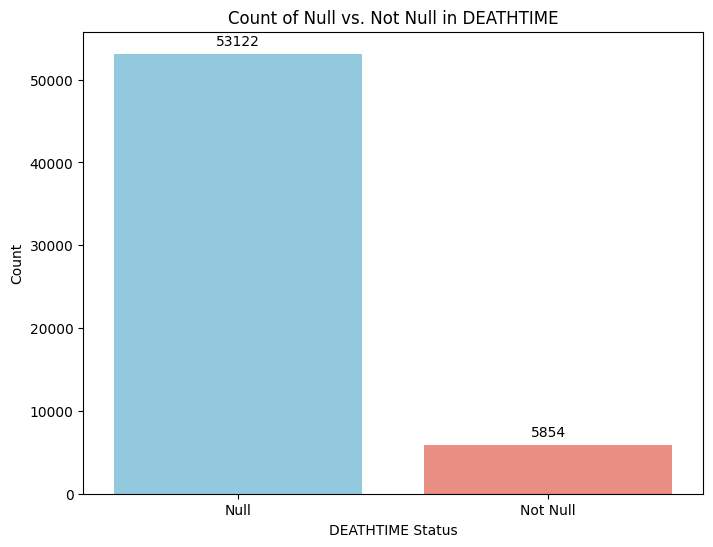

In [ ]:
import seaborn as sns
# Calculate counts
death_time_null_count = admission_df['DEATHTIME'].isnull().sum()
death_time_not_null_count = admission_df['DEATHTIME'].notnull().sum()

# Prepare data for plotting
death_counts = pd.Series([death_time_null_count, death_time_not_null_count], index=['Null', 'Not Null'])

# Convert to DataFrame for Seaborn compatibility
death_counts_df = death_counts.reset_index()
death_counts_df.columns = ['DEATHTIME Status', 'Count']

# Plotting the bar chart with Seaborn
plt.figure(figsize=(8, 6))
bar_plot = sns.barplot(x='DEATHTIME Status', y='Count', data=death_counts_df, palette=['skyblue', 'salmon'])

# Adding the text on the top of each bar
for p in bar_plot.patches:
    bar_plot.annotate(format(p.get_height(), '.0f'),
                      (p.get_x() + p.get_width() / 2., p.get_height()),
                      ha = 'center', va = 'center',
                      xytext = (0, 9),
                      textcoords = 'offset points')

plt.title('Count of Null vs. Not Null in DEATHTIME')
plt.xlabel('DEATHTIME Status')
plt.ylabel('Count')
plt.show()


In [ ]:
admission_df.count()

ROW_ID                  58976
SUBJECT_ID              58976
HADM_ID                 58976
ADMITTIME               58976
DISCHTIME               58976
DEATHTIME                5854
ADMISSION_TYPE          58976
ADMISSION_LOCATION      58976
DISCHARGE_LOCATION      58976
INSURANCE               58976
LANGUAGE                33644
RELIGION                58518
MARITAL_STATUS          48848
ETHNICITY               58976
EDREGTIME               30877
EDOUTTIME               30877
DIAGNOSIS               58951
HOSPITAL_EXPIRE_FLAG    58976
HAS_CHARTEVENTS_DATA    58976
dtype: int64

In [ ]:
admission_df.drop(admission_df[admission_df['DEATHTIME'].notnull()].index, inplace=True)

In [ ]:
admission_df.count()

ROW_ID                  53122
SUBJECT_ID              53122
HADM_ID                 53122
ADMITTIME               53122
DISCHTIME               53122
DEATHTIME                   0
ADMISSION_TYPE          53122
ADMISSION_LOCATION      53122
DISCHARGE_LOCATION      53122
INSURANCE               53122
LANGUAGE                30603
RELIGION                52761
MARITAL_STATUS          43655
ETHNICITY               53122
EDREGTIME               26792
EDOUTTIME               26792
DIAGNOSIS               53098
HOSPITAL_EXPIRE_FLAG    53122
HAS_CHARTEVENTS_DATA    53122
dtype: int64

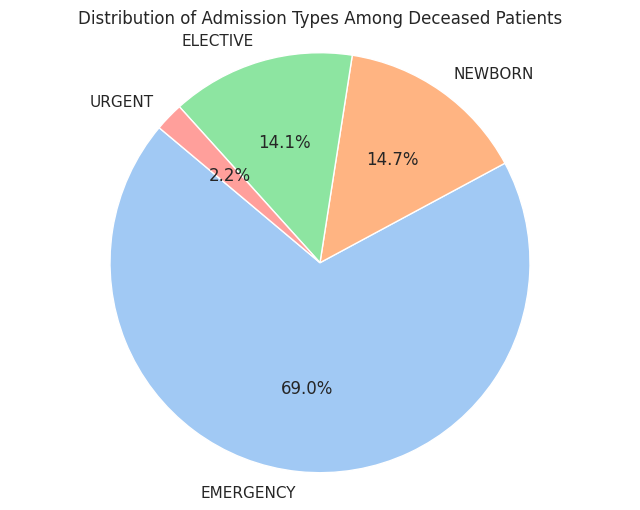

In [ ]:
sns.set(style="whitegrid")
# Get the distribution of admission types among deceased patients
admission_type_counts = admission_df['ADMISSION_TYPE'].value_counts()

# Plotting the pie chart
plt.figure(figsize=(8, 6))
plt.pie(admission_type_counts, labels=admission_type_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
plt.title('Distribution of Admission Types Among Deceased Patients')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()


In [ ]:
admission_df.dtypes

ROW_ID                   int64
SUBJECT_ID               int64
HADM_ID                  int64
ADMITTIME               object
DISCHTIME               object
DEATHTIME               object
ADMISSION_TYPE          object
ADMISSION_LOCATION      object
DISCHARGE_LOCATION      object
INSURANCE               object
LANGUAGE                object
RELIGION                object
MARITAL_STATUS          object
ETHNICITY               object
EDREGTIME               object
EDOUTTIME               object
DIAGNOSIS               object
HOSPITAL_EXPIRE_FLAG     int64
HAS_CHARTEVENTS_DATA     int64
dtype: object

In [ ]:
# Converting date columns to datetime type in 'admission_df'
admission_df['ADMITTIME'] = pd.to_datetime(admission_df['ADMITTIME'], format='%Y-%m-%d %H:%M:%S', errors='coerce')
admission_df['DISCHTIME'] = pd.to_datetime(admission_df['DISCHTIME'], format='%Y-%m-%d %H:%M:%S', errors='coerce')
admission_df['DEATHTIME'] = pd.to_datetime(admission_df['DEATHTIME'], format='%Y-%m-%d %H:%M:%S', errors='coerce')

# Check the data types to confirm the changes
admission_df.dtypes

ROW_ID                           int64
SUBJECT_ID                       int64
HADM_ID                          int64
ADMITTIME               datetime64[ns]
DISCHTIME               datetime64[ns]
DEATHTIME               datetime64[ns]
ADMISSION_TYPE                  object
ADMISSION_LOCATION              object
DISCHARGE_LOCATION              object
INSURANCE                       object
LANGUAGE                        object
RELIGION                        object
MARITAL_STATUS                  object
ETHNICITY                       object
EDREGTIME                       object
EDOUTTIME                       object
DIAGNOSIS                       object
HOSPITAL_EXPIRE_FLAG             int64
HAS_CHARTEVENTS_DATA             int64
dtype: object

In [ ]:
df_sorted = admission_df.sort_values(by=['SUBJECT_ID', 'ADMITTIME'])

# Group by SUBJECT_ID
grouped = df_sorted.groupby('SUBJECT_ID')
grouped.head()

,ROW_ID,SUBJECT_ID,HADM_ID,ADMITTIME,DISCHTIME,DEATHTIME,ADMISSION_TYPE,ADMISSION_LOCATION,DISCHARGE_LOCATION,INSURANCE,LANGUAGE,RELIGION,MARITAL_STATUS,ETHNICITY,EDREGTIME,EDOUTTIME,DIAGNOSIS,HOSPITAL_EXPIRE_FLAG,HAS_CHARTEVENTS_DATA
211,1,2,163353,2138-07-17 19:04:00,2138-07-21 15:48:00,NaT,NEWBORN,PHYS REFERRAL/NORMAL DELI,HOME,Private,NaN,NOT SPECIFIED,NaN,ASIAN,NaN,NaN,NEWBORN,0,1
212,2,3,145834,2101-10-20 19:08:00,2101-10-31 13:58:00,NaT,EMERGENCY,EMERGENCY ROOM ADMIT,SNF,Medicare,NaN,CATHOLIC,MARRIED,WHITE,2101-10-20 17:09:00,2101-10-20 19:24:00,HYPOTENSION,0,1
213,3,4,185777,2191-03-16 00:28:00,2191-03-23 18:41:00,NaT,EMERGENCY,EMERGENCY ROOM ADMIT,HOME WITH HOME IV PROVIDR,Private,NaN,PROTESTANT QUAKER,SINGLE,WHITE,2191-03-15 13:10:00,2191-03-16 01:10:00,"FEVER,DEHYDRATION,FAILURE TO THRIVE",0,1
214,4,5,178980,2103-02-02 04:31:00,2103-02-04 12:15:00,NaT,NEWBORN,PHYS REFERRAL/NORMAL DELI,HOME,Private,NaN,BUDDHIST,NaN,ASIAN,NaN,NaN,NEWBORN,0,1
215,5,6,107064,2175-05-30 07:15:00,2175-06-15 16:00:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME HEALTH CARE,Medicare,ENGL,NOT SPECIFIED,MARRIED,WHITE,NaN,NaN,CHRONIC RENAL FAILURE/SDA,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56435,58972,99985,176670,2181-01-27 02:47:00,2181-02-12 17:05:00,NaT,EMERGENCY,EMERGENCY ROOM ADMIT,HOME HEALTH CARE,Private,ENGL,JEWISH,MARRIED,WHITE,2181-01-26 23:35:00,2181-01-27 04:18:00,FEVER,0,1
56436,58973,99991,151118,2184-12-24 08:30:00,2185-01-05 12:15:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME,Private,ENGL,NOT SPECIFIED,MARRIED,WHITE,NaN,NaN,DIVERTICULITIS/SDA,0,1
56437,58974,99992,197084,2144-07-25 18:03:00,2144-07-28 17:56:00,NaT,EMERGENCY,CLINIC REFERRAL/PREMATURE,SNF,Medicare,ENGL,CATHOLIC,WIDOWED,WHITE,2144-07-25 13:40:00,2144-07-25 18:50:00,RETROPERITONEAL HEMORRHAGE,0,1
56565,58975,99995,137810,2147-02-08 08:00:00,2147-02-11 13:15:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME,Medicare,ENGL,NOT SPECIFIED,MARRIED,WHITE,NaN,NaN,ABDOMINAL AORTIC ANEURYSM/SDA,0,1


In [ ]:
# Calculate next admission time and number of days between admit times
df_sorted['next_admit_time'] = grouped['ADMITTIME'].shift(-1)
df_sorted['days_between_admits'] = df_sorted['next_admit_time'] - df_sorted['ADMITTIME']

df_sorted

,ROW_ID,SUBJECT_ID,HADM_ID,ADMITTIME,DISCHTIME,DEATHTIME,ADMISSION_TYPE,ADMISSION_LOCATION,DISCHARGE_LOCATION,INSURANCE,...,RELIGION,MARITAL_STATUS,ETHNICITY,EDREGTIME,EDOUTTIME,DIAGNOSIS,HOSPITAL_EXPIRE_FLAG,HAS_CHARTEVENTS_DATA,next_admit_time,days_between_admits
211,1,2,163353,2138-07-17 19:04:00,2138-07-21 15:48:00,NaT,NEWBORN,PHYS REFERRAL/NORMAL DELI,HOME,Private,...,NOT SPECIFIED,NaN,ASIAN,NaN,NaN,NEWBORN,0,1,NaT,NaT
212,2,3,145834,2101-10-20 19:08:00,2101-10-31 13:58:00,NaT,EMERGENCY,EMERGENCY ROOM ADMIT,SNF,Medicare,...,CATHOLIC,MARRIED,WHITE,2101-10-20 17:09:00,2101-10-20 19:24:00,HYPOTENSION,0,1,NaT,NaT
213,3,4,185777,2191-03-16 00:28:00,2191-03-23 18:41:00,NaT,EMERGENCY,EMERGENCY ROOM ADMIT,HOME WITH HOME IV PROVIDR,Private,...,PROTESTANT QUAKER,SINGLE,WHITE,2191-03-15 13:10:00,2191-03-16 01:10:00,"FEVER,DEHYDRATION,FAILURE TO THRIVE",0,1,NaT,NaT
214,4,5,178980,2103-02-02 04:31:00,2103-02-04 12:15:00,NaT,NEWBORN,PHYS REFERRAL/NORMAL DELI,HOME,Private,...,BUDDHIST,NaN,ASIAN,NaN,NaN,NEWBORN,0,1,NaT,NaT
215,5,6,107064,2175-05-30 07:15:00,2175-06-15 16:00:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME HEALTH CARE,Medicare,...,NOT SPECIFIED,MARRIED,WHITE,NaN,NaN,CHRONIC RENAL FAILURE/SDA,0,1,NaT,NaT
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56435,58972,99985,176670,2181-01-27 02:47:00,2181-02-12 17:05:00,NaT,EMERGENCY,EMERGENCY ROOM ADMIT,HOME HEALTH CARE,Private,...,JEWISH,MARRIED,WHITE,2181-01-26 23:35:00,2181-01-27 04:18:00,FEVER,0,1,NaT,NaT
56436,58973,99991,151118,2184-12-24 08:30:00,2185-01-05 12:15:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME,Private,...,NOT SPECIFIED,MARRIED,WHITE,NaN,NaN,DIVERTICULITIS/SDA,0,1,NaT,NaT
56437,58974,99992,197084,2144-07-25 18:03:00,2144-07-28 17:56:00,NaT,EMERGENCY,CLINIC REFERRAL/PREMATURE,SNF,Medicare,...,CATHOLIC,WIDOWED,WHITE,2144-07-25 13:40:00,2144-07-25 18:50:00,RETROPERITONEAL HEMORRHAGE,0,1,NaT,NaT
56565,58975,99995,137810,2147-02-08 08:00:00,2147-02-11 13:15:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME,Medicare,...,NOT SPECIFIED,MARRIED,WHITE,NaN,NaN,ABDOMINAL AORTIC ANEURYSM/SDA,0,1,NaT,NaT


In [ ]:
df_sorted[df_sorted['next_admit_time'].notnull()]

,ROW_ID,SUBJECT_ID,HADM_ID,ADMITTIME,DISCHTIME,DEATHTIME,ADMISSION_TYPE,ADMISSION_LOCATION,DISCHARGE_LOCATION,INSURANCE,...,RELIGION,MARITAL_STATUS,ETHNICITY,EDREGTIME,EDOUTTIME,DIAGNOSIS,HOSPITAL_EXPIRE_FLAG,HAS_CHARTEVENTS_DATA,next_admit_time,days_between_admits
224,14,17,194023,2134-12-27 07:15:00,2134-12-31 16:05:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME HEALTH CARE,Private,...,CATHOLIC,MARRIED,WHITE,NaN,NaN,PATIENT FORAMEN OVALE\ PATENT FORAMEN OVALE MI...,0,1,2135-05-09 14:11:00,133 days 06:56:00
1,22,23,152223,2153-09-03 07:15:00,2153-09-08 19:10:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME HEALTH CARE,Medicare,...,CATHOLIC,MARRIED,WHITE,NaN,NaN,CORONARY ARTERY DISEASE\CORONARY ARTERY BYPASS...,0,1,2157-10-18 19:34:00,1506 days 12:19:00
12,33,34,115799,2186-07-18 16:46:00,2186-07-20 16:00:00,NaT,EMERGENCY,TRANSFER FROM HOSP/EXTRAM,HOME,Medicare,...,CATHOLIC,MARRIED,WHITE,NaN,NaN,CHEST PAIN\CATH,0,1,2191-02-23 05:23:00,1680 days 12:37:00
15,36,36,182104,2131-04-30 07:15:00,2131-05-08 14:00:00,NaT,EMERGENCY,CLINIC REFERRAL/PREMATURE,HOME HEALTH CARE,Medicare,...,NOT SPECIFIED,MARRIED,WHITE,NaN,NaN,CORONARY ARTERY DISEASE\CORONARY ARTERY BYPASS...,0,1,2131-05-12 19:49:00,12 days 12:34:00
16,37,36,122659,2131-05-12 19:49:00,2131-05-25 13:30:00,NaT,EMERGENCY,EMERGENCY ROOM ADMIT,REHAB/DISTINCT PART HOSP,Medicare,...,NOT SPECIFIED,MARRIED,WHITE,2131-05-12 17:26:00,2131-05-12 22:17:00,CHEST PAIN/SHORTNESS OF BREATH,0,1,2134-05-10 11:30:00,1093 days 15:41:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56238,58940,99883,150755,2131-12-24 17:41:00,2131-12-27 17:45:00,NaT,EMERGENCY,TRANSFER FROM HOSP/EXTRAM,HOME,Medicare,...,PROTESTANT QUAKER,MARRIED,WHITE,NaN,NaN,CARDIOMYOPATHY\CARDIAC CATH,0,1,2132-09-15 00:36:00,265 days 06:55:00
56407,58944,99897,162913,2181-08-06 02:22:00,2181-08-07 16:30:00,NaT,EMERGENCY,CLINIC REFERRAL/PREMATURE,HOME,Private,...,7TH DAY ADVENTIST,MARRIED,BLACK/HAITIAN,2181-08-05 22:31:00,2181-08-06 04:13:00,HYPERGLYCEMIA,0,1,2182-07-03 19:50:00,331 days 17:28:00
56415,58952,99923,164914,2201-02-23 20:42:00,2201-03-03 16:00:00,NaT,EMERGENCY,CLINIC REFERRAL/PREMATURE,HOME,Private,...,CATHOLIC,MARRIED,WHITE,2201-02-23 15:54:00,2201-02-23 21:58:00,HYPONATREMIA,0,1,2201-05-15 13:12:00,80 days 16:30:00
56431,58968,99982,151454,2156-11-28 11:56:00,2156-12-08 13:45:00,NaT,EMERGENCY,PHYS REFERRAL/NORMAL DELI,HOME HEALTH CARE,Medicare,...,CATHOLIC,MARRIED,WHITE,NaN,NaN,TVR,0,1,2157-01-05 17:27:00,38 days 05:31:00


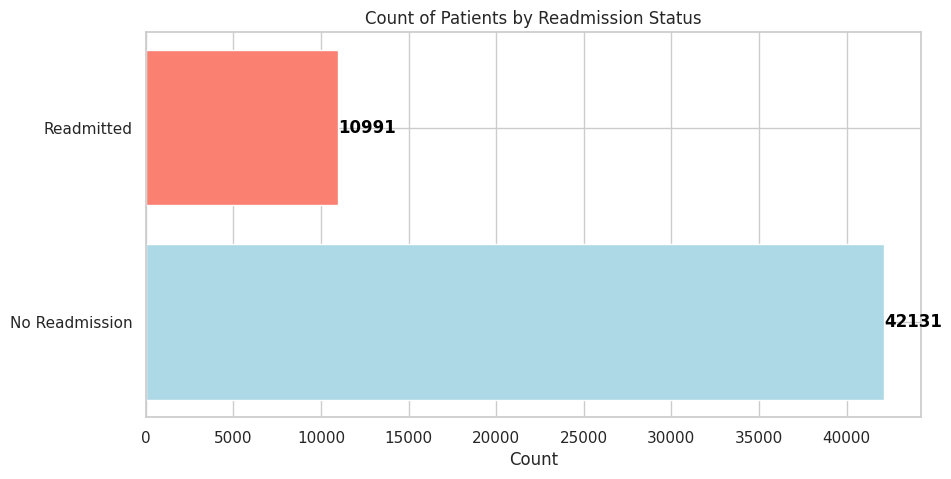

In [ ]:
# Counting null and not null values in the 'days_between_admits' column
days_between_admits_no_readmission = df_sorted['days_between_admits'].isnull().sum()
days_between_admits_readmitted = df_sorted['days_between_admits'].notnull().sum()

# Prepare data for plotting
counts = [days_between_admits_no_readmission, days_between_admits_readmitted]
statuses = ['No Readmission', 'Readmitted']

# Creating the horizontal bar chart
plt.figure(figsize=(10, 5))
bars = plt.barh(statuses, counts, color=['lightblue', 'salmon'])

# Adding text annotations
for bar in bars:
    plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2,
             f'{bar.get_width()}',
             va='center', ha='left', color='black', fontweight='bold')

# Adding labels and title
plt.xlabel('Count')
plt.title('Count of Patients by Readmission Status')
plt.show()


In [ ]:
df_sorted['days_between_admits'] = df_sorted['days_between_admits'].dt.days

df_sorted

,ROW_ID,SUBJECT_ID,HADM_ID,ADMITTIME,DISCHTIME,DEATHTIME,ADMISSION_TYPE,ADMISSION_LOCATION,DISCHARGE_LOCATION,INSURANCE,...,RELIGION,MARITAL_STATUS,ETHNICITY,EDREGTIME,EDOUTTIME,DIAGNOSIS,HOSPITAL_EXPIRE_FLAG,HAS_CHARTEVENTS_DATA,next_admit_time,days_between_admits
211,1,2,163353,2138-07-17 19:04:00,2138-07-21 15:48:00,NaT,NEWBORN,PHYS REFERRAL/NORMAL DELI,HOME,Private,...,NOT SPECIFIED,NaN,ASIAN,NaN,NaN,NEWBORN,0,1,NaT,NaN
212,2,3,145834,2101-10-20 19:08:00,2101-10-31 13:58:00,NaT,EMERGENCY,EMERGENCY ROOM ADMIT,SNF,Medicare,...,CATHOLIC,MARRIED,WHITE,2101-10-20 17:09:00,2101-10-20 19:24:00,HYPOTENSION,0,1,NaT,NaN
213,3,4,185777,2191-03-16 00:28:00,2191-03-23 18:41:00,NaT,EMERGENCY,EMERGENCY ROOM ADMIT,HOME WITH HOME IV PROVIDR,Private,...,PROTESTANT QUAKER,SINGLE,WHITE,2191-03-15 13:10:00,2191-03-16 01:10:00,"FEVER,DEHYDRATION,FAILURE TO THRIVE",0,1,NaT,NaN
214,4,5,178980,2103-02-02 04:31:00,2103-02-04 12:15:00,NaT,NEWBORN,PHYS REFERRAL/NORMAL DELI,HOME,Private,...,BUDDHIST,NaN,ASIAN,NaN,NaN,NEWBORN,0,1,NaT,NaN
215,5,6,107064,2175-05-30 07:15:00,2175-06-15 16:00:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME HEALTH CARE,Medicare,...,NOT SPECIFIED,MARRIED,WHITE,NaN,NaN,CHRONIC RENAL FAILURE/SDA,0,1,NaT,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56435,58972,99985,176670,2181-01-27 02:47:00,2181-02-12 17:05:00,NaT,EMERGENCY,EMERGENCY ROOM ADMIT,HOME HEALTH CARE,Private,...,JEWISH,MARRIED,WHITE,2181-01-26 23:35:00,2181-01-27 04:18:00,FEVER,0,1,NaT,NaN
56436,58973,99991,151118,2184-12-24 08:30:00,2185-01-05 12:15:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME,Private,...,NOT SPECIFIED,MARRIED,WHITE,NaN,NaN,DIVERTICULITIS/SDA,0,1,NaT,NaN
56437,58974,99992,197084,2144-07-25 18:03:00,2144-07-28 17:56:00,NaT,EMERGENCY,CLINIC REFERRAL/PREMATURE,SNF,Medicare,...,CATHOLIC,WIDOWED,WHITE,2144-07-25 13:40:00,2144-07-25 18:50:00,RETROPERITONEAL HEMORRHAGE,0,1,NaT,NaN
56565,58975,99995,137810,2147-02-08 08:00:00,2147-02-11 13:15:00,NaT,ELECTIVE,PHYS REFERRAL/NORMAL DELI,HOME,Medicare,...,NOT SPECIFIED,MARRIED,WHITE,NaN,NaN,ABDOMINAL AORTIC ANEURYSM/SDA,0,1,NaT,NaN


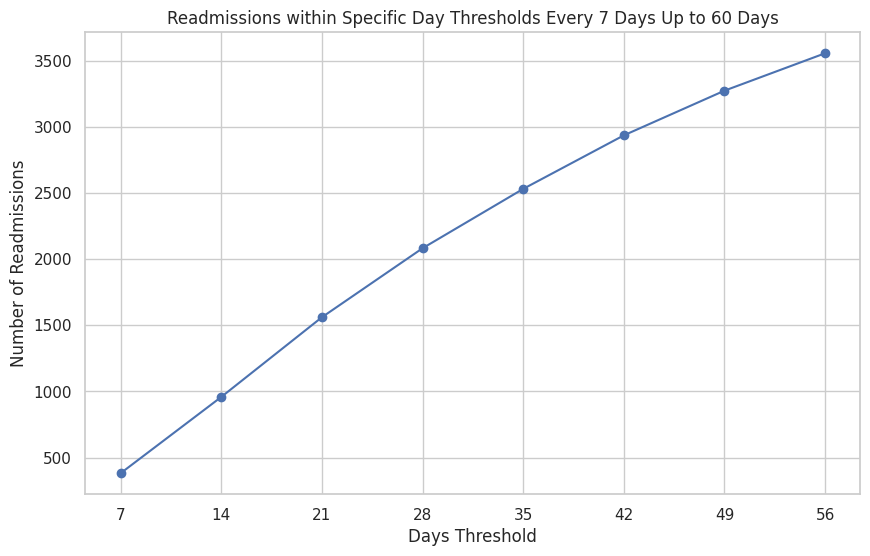

In [ ]:
# Define the range and step for day thresholds
max_days = 60
step = 7

# Initialize lists to store day thresholds and their corresponding counts
day_thresholds = list(range(step, max_days + 1, step))
counts = []

# Loop through each threshold to count readmissions
for days in day_thresholds:
    count = len(df_sorted[df_sorted['days_between_admits'] <= days])
    counts.append(count)

# Plotting the line chart
plt.figure(figsize=(10, 6))
plt.plot(day_thresholds, counts, marker='o', linestyle='-', color='b')

# Adding labels and title
plt.xlabel('Days Threshold')
plt.ylabel('Number of Readmissions')
plt.title('Readmissions within Specific Day Thresholds Every 7 Days Up to 60 Days')
plt.xticks(day_thresholds)  # Ensure x-axis shows all day thresholds
plt.grid(True)

# Show the chart
plt.show()

In [ ]:
records_count_31_days = len(df_sorted[df_sorted['days_between_admits'] <= 31])
print(records_count_31_days)

2266


In [ ]:
noteevents_df

,ROW_ID,SUBJECT_ID,HADM_ID,CHARTDATE,CHARTTIME,STORETIME,CATEGORY,DESCRIPTION,CGID,ISERROR,TEXT
0,174,22532,167853.0,2151-08-04,NaN,NaN,Discharge summary,Report,NaN,NaN,Admission Date: [**2151-7-16**] Dischar...
1,175,13702,107527.0,2118-06-14,NaN,NaN,Discharge summary,Report,NaN,NaN,Admission Date: [**2118-6-2**] Discharg...
2,176,13702,167118.0,2119-05-25,NaN,NaN,Discharge summary,Report,NaN,NaN,Admission Date: [**2119-5-4**] D...
3,177,13702,196489.0,2124-08-18,NaN,NaN,Discharge summary,Report,NaN,NaN,Admission Date: [**2124-7-21**] ...
4,178,26880,135453.0,2162-03-25,NaN,NaN,Discharge summary,Report,NaN,NaN,Admission Date: [**2162-3-3**] D...
...,...,...,...,...,...,...,...,...,...,...,...
2083175,2070657,31097,115637.0,2132-01-21,2132-01-21 03:27:00,2132-01-21 03:38:00,Nursing/other,Report,17581.0,NaN,NPN\n\n\n#1 Infant remains in RA with O2 sats...
2083176,2070658,31097,115637.0,2132-01-21,2132-01-21 09:50:00,2132-01-21 09:53:00,Nursing/other,Report,19211.0,NaN,"Neonatology\nDOL #5, CGA 36 weeks.\n\nCVR: Con..."
2083177,2070659,31097,115637.0,2132-01-21,2132-01-21 16:42:00,2132-01-21 16:44:00,Nursing/other,Report,20104.0,NaN,Family Meeting Note\nFamily meeting held with ...
2083178,2070660,31097,115637.0,2132-01-21,2132-01-21 18:05:00,2132-01-21 18:16:00,Nursing/other,Report,16023.0,NaN,NPN 1800\n\n\n#1 Resp: [**Known lastname 2243*...


In [ ]:
noteevents_df.dtypes

ROW_ID           int64
SUBJECT_ID       int64
HADM_ID        float64
CHARTDATE       object
CHARTTIME       object
STORETIME       object
CATEGORY        object
DESCRIPTION     object
CGID           float64
ISERROR        float64
TEXT            object
dtype: object

In [ ]:
noteevents_df['CHARTDATE'] = pd.to_datetime(noteevents_df['CHARTDATE'], format='%Y-%m-%d', errors='coerce')

In [ ]:
noteevents_df['CHARTTIME'] = pd.to_datetime(noteevents_df['CHARTTIME'], format='%Y-%m-%d %H:%M:%S', errors='coerce')

In [ ]:
# Sort the DataFrame by SUBJECT_ID, CHARTDATE, and CHARTTIME
noteevents_df_sorted = noteevents_df.sort_values(by=['SUBJECT_ID', 'CHARTDATE', 'CHARTTIME'])

# Group by SUBJECT_ID and concatenate the text
concatenated_text_df = noteevents_df_sorted.groupby(['SUBJECT_ID'])['TEXT'].agg(lambda x: ' '.join(x)).reset_index()

concatenated_text_df

,SUBJECT_ID,TEXT
0,2,Neonatology Attending Triage Note\n\nBaby [**N...
1,3,[**2101-10-6**] 6:02 PM\n CHEST (PORTABLE AP) ...
2,4,[**2191-3-15**] 4:20 PM\n CHEST (PORTABLE AP) ...
3,5,NNP Triage Note\n\nBB [**Known lastname 6**] d...
4,6,[**2175-5-25**] 10:52 AM\n CHEST (PRE-OP PA & ...
...,...,...
46141,99985,Sinus rhythm. Normal ECG. Since the previous t...
46142,99991,[**2184-12-27**] 11:35 AM\n CHEST (PA & LAT) ...
46143,99992,[**2144-7-10**] 8:04 AM\n CHEST PORT. LINE PLA...
46144,99995,[**2147-1-10**] 8:15 AM\n CAROTID SERIES COMPL...


In [ ]:
pd.set_option('display.max_colwidth', None)

In [ ]:
# Merge DataFrames based on the 'SUBJECT_ID' column
merged_df = pd.merge(df_sorted, concatenated_text_df, on='SUBJECT_ID', how='left')
merged_df

ROW_ID  SUBJECT_ID  HADM_ID           ADMITTIME           DISCHTIME  \
0           1           2   163353 2138-07-17 19:04:00 2138-07-21 15:48:00   
1           2           3   145834 2101-10-20 19:08:00 2101-10-31 13:58:00   
2           3           4   185777 2191-03-16 00:28:00 2191-03-23 18:41:00   
3           4           5   178980 2103-02-02 04:31:00 2103-02-04 12:15:00   
4           5           6   107064 2175-05-30 07:15:00 2175-06-15 16:00:00   
...       ...         ...      ...                 ...                 ...   
53117   58972       99985   176670 2181-01-27 02:47:00 2181-02-12 17:05:00   
53118   58973       99991   151118 2184-12-24 08:30:00 2185-01-05 12:15:00   
53119   58974       99992   197084 2144-07-25 18:03:00 2144-07-28 17:56:00   
53120   58975       99995   137810 2147-02-08 08:00:00 2147-02-11 13:15:00   
53121   58976       99999   113369 2117-12-30 07:15:00 2118-01-04 16:30:00   

      DEATHTIME ADMISSION_TYPE         ADMISSION_LOCATION  \
0           NaT        NEWBORN  PHYS REFERRAL/NORMAL DELI   
1           NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
2           NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
3           NaT        NEWBORN  PHYS REFERRAL/NORMAL DELI   
4           NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
...         ...            ...                        ...   
53117       NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
53118       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
53119       NaT      EMERGENCY  CLINIC REFERRAL/PREMATURE   
53120       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
53121       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   

              DISCHARGE_LOCATION INSURANCE  ... MARITAL_STATUS  \
0                           HOME   Private  ...            NaN   
1                            SNF  Medicare  ...        MARRIED   
2      HOME WITH HOME IV PROVIDR   Private  ...         SINGLE   
3                           HOME   Private  ...            NaN   
4               HOME HEALTH CARE  Medicare  ...        MARRIED   
...                          ...       ...  ...            ...   
53117           HOME HEALTH CARE   Private  ...        MARRIED   
53118                       HOME   Private  ...        MARRIED   
53119                        SNF  Medicare  ...        WIDOWED   
53120                       HOME  Medicare  ...        MARRIED   
53121                        SNF  Medicare  ...      SEPARATED   

                ETHNICITY            EDREGTIME            EDOUTTIME  \
0                   ASIAN                  NaN                  NaN   
1                   WHITE  2101-10-20 17:09:00  2101-10-20 19:24:00   
2                   WHITE  2191-03-15 13:10:00  2191-03-16 01:10:00   
3                   ASIAN                  NaN                  NaN   
4                   WHITE                  NaN                  NaN   
...                   ...                  ...                  ...   
53117               WHITE  2181-01-26 23:35:00  2181-01-27 04:18:00   
53118               WHITE                  NaN                  NaN   
53119               WHITE  2144-07-25 13:40:00  2144-07-25 18:50:00   
53120               WHITE                  NaN                  NaN   
53121  HISPANIC OR LATINO                  NaN                  NaN   

                                 DIAGNOSIS HOSPITAL_EXPIRE_FLAG  \
0                                  NEWBORN                    0   
1                              HYPOTENSION                    0   
2      FEVER,DEHYDRATION,FAILURE TO THRIVE                    0   
3                                  NEWBORN                    0   
4                CHRONIC RENAL FAILURE/SDA                    0   
...                                    ...                  ...   
53117                                FEVER                    0   
53118                   DIVERTICULITIS/SDA                    0   
53119           RETROPERITONEAL HEMORRHAGE                    0   
53120        ABDOMINA

In [ ]:
merged_df.isnull().sum()

ROW_ID                      0
SUBJECT_ID                  0
HADM_ID                     0
ADMITTIME                   0
DISCHTIME                   0
DEATHTIME               53122
ADMISSION_TYPE              0
ADMISSION_LOCATION          0
DISCHARGE_LOCATION          0
INSURANCE                   0
LANGUAGE                22519
RELIGION                  361
MARITAL_STATUS           9467
ETHNICITY                   0
EDREGTIME               26330
EDOUTTIME               26330
DIAGNOSIS                  24
HOSPITAL_EXPIRE_FLAG        0
HAS_CHARTEVENTS_DATA        0
next_admit_time         42131
days_between_admits     42131
TEXT                      168
dtype: int64

In [ ]:
# Create a new column 'readmitted' based on the condition 'days_between_admits <= 30'
merged_df['readmitted'] = np.where(merged_df['days_between_admits'] <= 31, 1, 0)

merged_df

ROW_ID  SUBJECT_ID  HADM_ID           ADMITTIME           DISCHTIME  \
0           1           2   163353 2138-07-17 19:04:00 2138-07-21 15:48:00   
1           2           3   145834 2101-10-20 19:08:00 2101-10-31 13:58:00   
2           3           4   185777 2191-03-16 00:28:00 2191-03-23 18:41:00   
3           4           5   178980 2103-02-02 04:31:00 2103-02-04 12:15:00   
4           5           6   107064 2175-05-30 07:15:00 2175-06-15 16:00:00   
...       ...         ...      ...                 ...                 ...   
53117   58972       99985   176670 2181-01-27 02:47:00 2181-02-12 17:05:00   
53118   58973       99991   151118 2184-12-24 08:30:00 2185-01-05 12:15:00   
53119   58974       99992   197084 2144-07-25 18:03:00 2144-07-28 17:56:00   
53120   58975       99995   137810 2147-02-08 08:00:00 2147-02-11 13:15:00   
53121   58976       99999   113369 2117-12-30 07:15:00 2118-01-04 16:30:00   

      DEATHTIME ADMISSION_TYPE         ADMISSION_LOCATION  \
0           NaT        NEWBORN  PHYS REFERRAL/NORMAL DELI   
1           NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
2           NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
3           NaT        NEWBORN  PHYS REFERRAL/NORMAL DELI   
4           NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
...         ...            ...                        ...   
53117       NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
53118       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
53119       NaT      EMERGENCY  CLINIC REFERRAL/PREMATURE   
53120       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
53121       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   

              DISCHARGE_LOCATION INSURANCE  ...           ETHNICITY  \
0                           HOME   Private  ...               ASIAN   
1                            SNF  Medicare  ...               WHITE   
2      HOME WITH HOME IV PROVIDR   Private  ...               WHITE   
3                           HOME   Private  ...               ASIAN   
4               HOME HEALTH CARE  Medicare  ...               WHITE   
...                          ...       ...  ...                 ...   
53117           HOME HEALTH CARE   Private  ...               WHITE   
53118                       HOME   Private  ...               WHITE   
53119                        SNF  Medicare  ...               WHITE   
53120                       HOME  Medicare  ...               WHITE   
53121                        SNF  Medicare  ...  HISPANIC OR LATINO   

                 EDREGTIME            EDOUTTIME  \
0                      NaN                  NaN   
1      2101-10-20 17:09:00  2101-10-20 19:24:00   
2      2191-03-15 13:10:00  2191-03-16 01:10:00   
3                      NaN                  NaN   
4                      NaN                  NaN   
...                    ...                  ...   
53117  2181-01-26 23:35:00  2181-01-27 04:18:00   
53118                  NaN                  NaN   
53119  2144-07-25 13:40:00  2144-07-25 18:50:00   
53120                  NaN                  NaN   
53121                  NaN                  NaN   

                                 DIAGNOSIS HOSPITAL_EXPIRE_FLAG  \
0                                  NEWBORN                    0   
1                              HYPOTENSION                    0   
2      FEVER,DEHYDRATION,FAILURE TO THRIVE                    0   
3                                  NEWBORN                    0   
4                CHRONIC RENAL FAILURE/SDA                    0   
...                                    ...                  ...   
53117                                FEVER                    0   
53118                   DIVERTICULITIS/SDA                    0   
53119           RETROPERITONEAL HEMORRHAGE                    0   
53120        ABDOMINAL AORTIC ANEURYSM/SDA                    0   
53121                SPONDYLOLISTHESIS/SDA                    0   

      HAS_CHARTEVENTS_DATA next_admit_time  days_between_admits  \

In [ ]:
merged_df['TEXT'] = merged_df['TEXT'].str.lower()
merged_df['TEXT'] = merged_df['TEXT'].str.replace('\n', '')
merged_df['TEXT'] = merged_df['TEXT'].str.replace('\r', '')

merged_df

ROW_ID  SUBJECT_ID  HADM_ID           ADMITTIME           DISCHTIME  \
0           1           2   163353 2138-07-17 19:04:00 2138-07-21 15:48:00   
1           2           3   145834 2101-10-20 19:08:00 2101-10-31 13:58:00   
2           3           4   185777 2191-03-16 00:28:00 2191-03-23 18:41:00   
3           4           5   178980 2103-02-02 04:31:00 2103-02-04 12:15:00   
4           5           6   107064 2175-05-30 07:15:00 2175-06-15 16:00:00   
...       ...         ...      ...                 ...                 ...   
53117   58972       99985   176670 2181-01-27 02:47:00 2181-02-12 17:05:00   
53118   58973       99991   151118 2184-12-24 08:30:00 2185-01-05 12:15:00   
53119   58974       99992   197084 2144-07-25 18:03:00 2144-07-28 17:56:00   
53120   58975       99995   137810 2147-02-08 08:00:00 2147-02-11 13:15:00   
53121   58976       99999   113369 2117-12-30 07:15:00 2118-01-04 16:30:00   

      DEATHTIME ADMISSION_TYPE         ADMISSION_LOCATION  \
0           NaT        NEWBORN  PHYS REFERRAL/NORMAL DELI   
1           NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
2           NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
3           NaT        NEWBORN  PHYS REFERRAL/NORMAL DELI   
4           NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
...         ...            ...                        ...   
53117       NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
53118       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
53119       NaT      EMERGENCY  CLINIC REFERRAL/PREMATURE   
53120       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
53121       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   

              DISCHARGE_LOCATION INSURANCE  ...           ETHNICITY  \
0                           HOME   Private  ...               ASIAN   
1                            SNF  Medicare  ...               WHITE   
2      HOME WITH HOME IV PROVIDR   Private  ...               WHITE   
3                           HOME   Private  ...               ASIAN   
4               HOME HEALTH CARE  Medicare  ...               WHITE   
...                          ...       ...  ...                 ...   
53117           HOME HEALTH CARE   Private  ...               WHITE   
53118                       HOME   Private  ...               WHITE   
53119                        SNF  Medicare  ...               WHITE   
53120                       HOME  Medicare  ...               WHITE   
53121                        SNF  Medicare  ...  HISPANIC OR LATINO   

                 EDREGTIME            EDOUTTIME  \
0                      NaN                  NaN   
1      2101-10-20 17:09:00  2101-10-20 19:24:00   
2      2191-03-15 13:10:00  2191-03-16 01:10:00   
3                      NaN                  NaN   
4                      NaN                  NaN   
...                    ...                  ...   
53117  2181-01-26 23:35:00  2181-01-27 04:18:00   
53118                  NaN                  NaN   
53119  2144-07-25 13:40:00  2144-07-25 18:50:00   
53120                  NaN                  NaN   
53121                  NaN                  NaN   

                                 DIAGNOSIS HOSPITAL_EXPIRE_FLAG  \
0                                  NEWBORN                    0   
1                              HYPOTENSION                    0   
2      FEVER,DEHYDRATION,FAILURE TO THRIVE                    0   
3                                  NEWBORN                    0   
4                CHRONIC RENAL FAILURE/SDA                    0   
...                                    ...                  ...   
53117                                FEVER                    0   
53118                   DIVERTICULITIS/SDA                    0   
53119           RETROPERITONEAL HEMORRHAGE                    0   
53120        ABDOMINAL AORTIC ANEURYSM/SDA                    0   
53121                SPONDYLOLISTHESIS/SDA                    0   

      HAS_CHARTEVENTS_DATA next_admit_time  days_between_admits  \

In [ ]:
merged_df['TEXT'].iloc[0]

"neonatology attending triage notebaby [**name (ni) 1**] [**known lastname 2**] is a term male infant admitted to the nicu for sepsis evaluation.  asked to evaluate baby by dr. [**first name4 (namepattern1) 3**] [**last name (namepattern1) 4**].mother is 34 years old g1 p0-1.pns:  a pos, ab neg, hbsag neg, rpr nr, ri, gbs neg.pregnancy was uncomplicated.delivery was by c-section after failure to progress.  apgars 9,9.mother was treated with antibiotics because of maternal temp of 100.3 just prior to delivery.  mother's temp was then lower but at 2 hours rose again to 102.pe - baby is [**name2 (ni) 5**] and vigorous, aga.vs -  t 98.5 hr 145 rr 38 bp 72/35 48, o2 sat 100% in raheent - af soft and flat, some molding noted.palate intact.resp - breath sounds clear and equal.cvs - s1 s2 normal, [**3-18**] high pitched systolic murmur at lsbabd - soft with normal bowel sounds, no organomegalygu - normal male with testes descended bilaterallyneuro - tone wnl, symmetrical examds - 72assessment/

In [ ]:
import nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

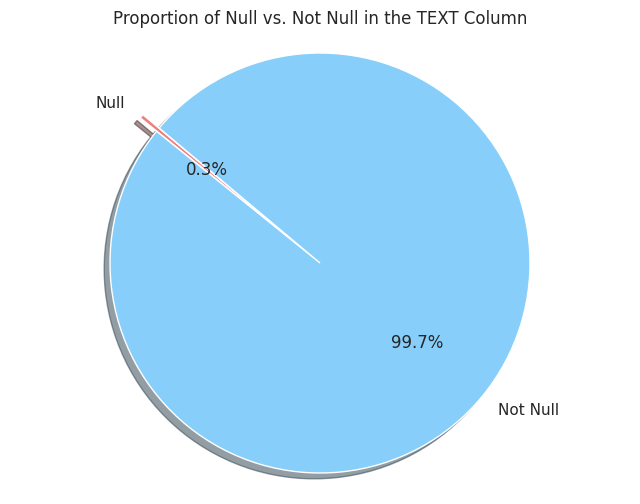

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Count the occurrence of null and non-null values
text_null_count = merged_df['TEXT'].isnull().sum()
text_not_null_count = merged_df['TEXT'].notnull().sum()

# Prepare data for the pie chart
labels = 'Null', 'Not Null'
sizes = [text_null_count, text_not_null_count]
colors = ['lightcoral', 'lightskyblue']
explode = (0.1, 0)  # explode 1st slice

# Plotting the pie chart
plt.figure(figsize=(8, 6))
plt.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%', shadow=True, startangle=140)
plt.title('Proportion of Null vs. Not Null in the TEXT Column')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()


In [ ]:
merged_df.dropna(subset=['TEXT'], inplace=True)

In [ ]:
import re
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
# Remove PII using regex
merged_df['TEXT'] = merged_df['TEXT'].str.replace(r'\[\*\*.*?\*\*\]', '', regex=True)

In [ ]:
# Define function to remove special characters
def remove_special_characters(text):
    return re.sub(r'[^a-zA-Z0-9\s]', '', text)

# Remove special characters
merged_df['TEXT'] = merged_df['TEXT'].apply(remove_special_characters)


In [ ]:
merged_df

ROW_ID  SUBJECT_ID  HADM_ID           ADMITTIME           DISCHTIME  \
0           1           2   163353 2138-07-17 19:04:00 2138-07-21 15:48:00   
1           2           3   145834 2101-10-20 19:08:00 2101-10-31 13:58:00   
2           3           4   185777 2191-03-16 00:28:00 2191-03-23 18:41:00   
3           4           5   178980 2103-02-02 04:31:00 2103-02-04 12:15:00   
4           5           6   107064 2175-05-30 07:15:00 2175-06-15 16:00:00   
...       ...         ...      ...                 ...                 ...   
53117   58972       99985   176670 2181-01-27 02:47:00 2181-02-12 17:05:00   
53118   58973       99991   151118 2184-12-24 08:30:00 2185-01-05 12:15:00   
53119   58974       99992   197084 2144-07-25 18:03:00 2144-07-28 17:56:00   
53120   58975       99995   137810 2147-02-08 08:00:00 2147-02-11 13:15:00   
53121   58976       99999   113369 2117-12-30 07:15:00 2118-01-04 16:30:00   

      DEATHTIME ADMISSION_TYPE         ADMISSION_LOCATION  \
0           NaT        NEWBORN  PHYS REFERRAL/NORMAL DELI   
1           NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
2           NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
3           NaT        NEWBORN  PHYS REFERRAL/NORMAL DELI   
4           NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
...         ...            ...                        ...   
53117       NaT      EMERGENCY       EMERGENCY ROOM ADMIT   
53118       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
53119       NaT      EMERGENCY  CLINIC REFERRAL/PREMATURE   
53120       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   
53121       NaT       ELECTIVE  PHYS REFERRAL/NORMAL DELI   

              DISCHARGE_LOCATION INSURANCE  ...            EDREGTIME  \
0                           HOME   Private  ...                  NaN   
1                            SNF  Medicare  ...  2101-10-20 17:09:00   
2      HOME WITH HOME IV PROVIDR   Private  ...  2191-03-15 13:10:00   
3                           HOME   Private  ...                  NaN   
4               HOME HEALTH CARE  Medicare  ...                  NaN   
...                          ...       ...  ...                  ...   
53117           HOME HEALTH CARE   Private  ...  2181-01-26 23:35:00   
53118                       HOME   Private  ...                  NaN   
53119                        SNF  Medicare  ...  2144-07-25 13:40:00   
53120                       HOME  Medicare  ...                  NaN   
53121                        SNF  Medicare  ...                  NaN   

                 EDOUTTIME                            DIAGNOSIS  \
0                      NaN                              NEWBORN   
1      2101-10-20 19:24:00                          HYPOTENSION   
2      2191-03-16 01:10:00  FEVER,DEHYDRATION,FAILURE TO THRIVE   
3                      NaN                              NEWBORN   
4                      NaN            CHRONIC RENAL FAILURE/SDA   
...                    ...                                  ...   
53117  2181-01-27 04:18:00                                FEVER   
53118                  NaN                   DIVERTICULITIS/SDA   
53119  2144-07-25 18:50:00           RETROPERITONEAL HEMORRHAGE   
53120                  NaN        ABDOMINAL AORTIC ANEURYSM/SDA   
53121                  NaN                SPONDYLOLISTHESIS/SDA   

      HOSPITAL_EXPIRE_FLAG HAS_CHARTEVENTS_DATA next_admit_time  \
0                        0                    1             NaT   
1                        0                    1             NaT   
2                        0                    1             NaT   
3                        0                    1             NaT   
4                        0                    1             NaT   
...                    ...                  ...             ...   
53117                    0                    1             NaT   
53118                    0                    1             NaT   
53119                    0                    1             NaT 

/tmp/ipykernel_3580/2750088857.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=admission_type_counts.index, y=admission_type_counts.values, palette='viridis')
/tmp/ipykernel_3580/2750088857.py:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=admission_location_counts.index, y=admission_location_counts.values, palette='viridis')
/tmp/ipykernel_3580/2750088857.py:36: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=discharge_location_counts.index, y=discharge_location_counts.values, palette='viridis')


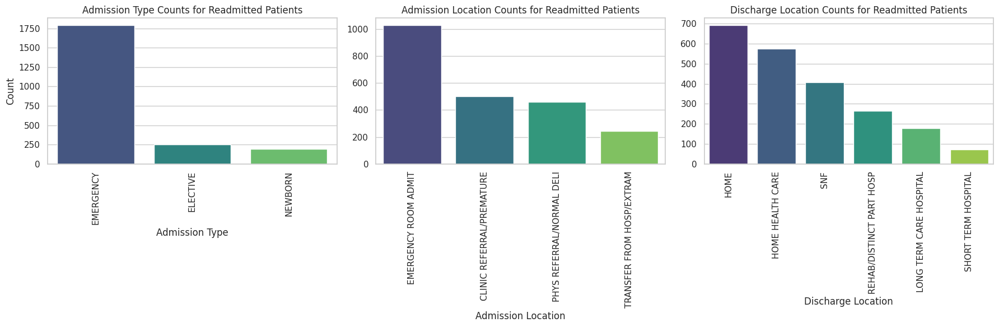

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filter the DataFrame for rows where 'readmitted' is 1
readmitted_df = merged_df[merged_df['readmitted'] == 1]

# Set up the matplotlib figure
plt.figure(figsize=(18, 6))

# Plot 1: Admission Type Counts
plt.subplot(131)  # 1 row, 3 columns, 1st subplot
admission_type_counts = readmitted_df['ADMISSION_TYPE'].value_counts()
# Filter out categories with counts less than 5
admission_type_counts = admission_type_counts[admission_type_counts >= 50]
sns.barplot(x=admission_type_counts.index, y=admission_type_counts.values, palette='viridis')
plt.title('Admission Type Counts for Readmitted Patients')
plt.xticks(rotation=90)
plt.xlabel('Admission Type')
plt.ylabel('Count')

# Plot 2: Admission Location Counts
plt.subplot(132)  # 1 row, 3 columns, 2nd subplot
admission_location_counts = readmitted_df['ADMISSION_LOCATION'].value_counts()
# Filter out categories with counts less than 5
admission_location_counts = admission_location_counts[admission_location_counts >= 50]
sns.barplot(x=admission_location_counts.index, y=admission_location_counts.values, palette='viridis')
plt.title('Admission Location Counts for Readmitted Patients')
plt.xticks(rotation=90)
plt.xlabel('Admission Location')

# Plot 3: Discharge Location Counts
plt.subplot(133)  # 1 row, 3 columns, 3rd subplot
discharge_location_counts = readmitted_df['DISCHARGE_LOCATION'].value_counts()
# Filter out categories with counts less than 5
discharge_location_counts = discharge_location_counts[discharge_location_counts >= 50]
sns.barplot(x=discharge_location_counts.index, y=discharge_location_counts.values, palette='viridis')
plt.title('Discharge Location Counts for Readmitted Patients')
plt.xticks(rotation=90)
plt.xlabel('Discharge Location')

# Adjust layout
plt.tight_layout()
plt.show()


In [ ]:
model_df = merged_df[['SUBJECT_ID', 'HADM_ID', 'TEXT', 'readmitted']].copy()

In [ ]:
model_df

SUBJECT_ID  HADM_ID  \
0               2   163353   
1               3   145834   
2               4   185777   
3               5   178980   
4               6   107064   
...           ...      ...   
53117       99985   176670   
53118       99991   151118   
53119       99992   197084   
53120       99995   137810   
53121       99999   113369   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              

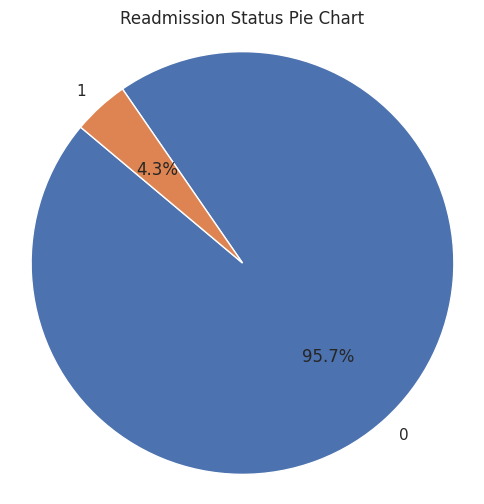

In [ ]:
import matplotlib.pyplot as plt

# Count the occurrences of each value in the 'readmitted' column
readmitted_counts = model_df['readmitted'].value_counts()

# Create a pie chart
plt.figure(figsize=(6, 6))
plt.pie(readmitted_counts, labels=readmitted_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Readmission Status Pie Chart')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle
plt.show()

In [ ]:
!pip install scikit-learn

In [ ]:
import sklearn
from sklearn.model_selection import train_test_split

# Split into train (70%) and temp (30%)
train_df, temp_df = train_test_split(model_df, test_size=0.3, random_state=42)
test_df, validation_df = train_test_split(temp_df, test_size=0.5, random_state=42)

# Print the shapes of the split DataFrames
print("Train set shape:", train_df.shape)
print("Test set shape:", test_df.shape)
print("Validation set shape:", validation_df.shape)

Train set shape: (37067, 4)
Test set shape: (7943, 4)
Validation set shape: (7944, 4)


In [ ]:
train_df

SUBJECT_ID  HADM_ID  \
32138       29226   112295   
38545       49359   144898   
46721       77654   163742   
14384       13010   116862   
24569       22320   177984   
...           ...      ...   
11306       10254   189762   
44876       71143   163828   
38283       48373   161511   
860           774   105216   
15829       14313   152033   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              

In [ ]:
train_df.dtypes

SUBJECT_ID     int64
HADM_ID        int64
TEXT          object
readmitted     int64
dtype: object

In [ ]:
(train_df['readmitted'] == 1).sum()

1608

In [ ]:
(train_df['readmitted'] == 0).sum()

35459